## Further Exploring Oil Well Locations & Health Outcomes in Kern County

This week I'll be exploring the oil wells in Kern County data and trying to make the CalEnviroScreen data useable/mergeable with the other Census data that my group is using.

I'll also be searching for and exploring potential data on agriculture in the county (e.g. crop boundaries) to see if it will be possible to begin examining the relationship between oil and gas activities and environmental risks to food production in the County.

### Making CalEnviroScreen 4.0 Data Mergeable With Other Data

In [3]:
## importing libraries
import pandas as pd
import geopandas as gpd

In [4]:
## Pulling uncorrupted census tract values from CalEnviroScreen excel data
CES4data = pd.read_excel('calenviroscreen40resultsdatadictionary_F_2021.xlsx')
CES4data.head()

,Census Tract,Total Population,California County,ZIP,Approximate Location,Longitude,Latitude,CES 4.0 Score,CES 4.0 Percentile,CES 4.0 Percentile Range,...,Linguistic Isolation Pctl,Poverty,Poverty Pctl,Unemployment,Unemployment Pctl,Housing Burden,Housing Burden Pctl,Pop. Char.,Pop. Char. Score,Pop. Char. Pctl
0,6019001100,2780,Fresno,93706,Fresno,-119.781696,36.709695,93.183570,100.000000,95-100% (highest scores),...,79.374746,76.0,98.919598,12.8,93.831338,30.3,91.039290,93.155109,9.663213,99.722642
1,6077000700,4680,San Joaquin,95206,Stockton,-121.287873,37.943173,86.653790,99.987393,95-100% (highest scores),...,95.533902,73.2,98.391960,19.8,99.206143,31.2,92.281369,93.165408,9.664281,99.735250
2,6037204920,2751,Los Angeles,90023,Los Angeles,-118.197497,34.017500,82.393909,99.974786,95-100% (highest scores),...,81.553661,62.6,93.391960,6.4,61.530453,20.3,63.967047,83.751814,8.687785,95.789208
3,6019000700,3664,Fresno,93706,Fresno,-119.827707,36.734535,81.327940,99.962179,95-100% (highest scores),...,78.711598,65.7,95.351759,15.7,97.345133,35.4,96.413181,94.641227,9.817371,99.886536
4,6019000200,2689,Fresno,93706,Fresno,-119.805504,36.735491,80.745476,99.949571,95-100% (highest scores),...,86.561104,72.7,98.304020,13.7,95.288912,32.7,94.157161,95.398873,9.895964,99.949571


In [5]:
CES4data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8035 entries, 0 to 8034
Data columns (total 58 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Census Tract                 8035 non-null   int64  
 1   Total Population             8035 non-null   int64  
 2   California County            8035 non-null   object 
 3   ZIP                          8035 non-null   int64  
 4   Approximate Location         8035 non-null   object 
 5   Longitude                    8035 non-null   float64
 6   Latitude                     8035 non-null   float64
 7   CES 4.0 Score                7932 non-null   float64
 8   CES 4.0 Percentile           7932 non-null   float64
 9   CES 4.0 Percentile Range     7932 non-null   object 
 10  Ozone                        8035 non-null   float64
 11  Ozone Pctl                   8035 non-null   float64
 12  PM2.5                        8035 non-null   float64
 13  PM2.5 Pctl        

In [6]:
## Recoding FIPS/Geo ID columns as strings
CES4data = pd.read_excel('calenviroscreen40resultsdatadictionary_F_2021.xlsx',
 dtype=
    {
        'Census Tract':str
    })

In [7]:
CES4data['Census Tract'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 8035 entries, 0 to 8034
Series name: Census Tract
Non-Null Count  Dtype 
--------------  ----- 
8035 non-null   object
dtypes: object(1)
memory usage: 62.9+ KB


In [8]:
## Creating new FIPS column with Census Tract column
CES4data['FIPS'] = "0"+CES4data['Census Tract'].copy()
CES4data['FIPS'].sample(5)

3541    06037900609
7987    06037980028
1070    06029002900
2661    06037408402
7303    06073017022
Name: FIPS, dtype: object

In [9]:
CES4data.head()

,Census Tract,Total Population,California County,ZIP,Approximate Location,Longitude,Latitude,CES 4.0 Score,CES 4.0 Percentile,CES 4.0 Percentile Range,...,Poverty,Poverty Pctl,Unemployment,Unemployment Pctl,Housing Burden,Housing Burden Pctl,Pop. Char.,Pop. Char. Score,Pop. Char. Pctl,FIPS
0,6019001100,2780,Fresno,93706,Fresno,-119.781696,36.709695,93.183570,100.000000,95-100% (highest scores),...,76.0,98.919598,12.8,93.831338,30.3,91.039290,93.155109,9.663213,99.722642,06019001100
1,6077000700,4680,San Joaquin,95206,Stockton,-121.287873,37.943173,86.653790,99.987393,95-100% (highest scores),...,73.2,98.391960,19.8,99.206143,31.2,92.281369,93.165408,9.664281,99.735250,06077000700
2,6037204920,2751,Los Angeles,90023,Los Angeles,-118.197497,34.017500,82.393909,99.974786,95-100% (highest scores),...,62.6,93.391960,6.4,61.530453,20.3,63.967047,83.751814,8.687785,95.789208,06037204920
3,6019000700,3664,Fresno,93706,Fresno,-119.827707,36.734535,81.327940,99.962179,95-100% (highest scores),...,65.7,95.351759,15.7,97.345133,35.4,96.413181,94.641227,9.817371,99.886536,06019000700
4,6019000200,2689,Fresno,93706,Fresno,-119.805504,36.735491,80.745476,99.949571,95-100% (highest scores),...,72.7,98.304020,13.7,95.288912,32.7,94.157161,95.398873,9.895964,99.949571,06019000200


In [10]:
## Trimming colummns
CES4datatrimmed = CES4data[['Census Tract','California County','Longitude','Latitude','FIPS']]
CES4datatrimmed.head(5)

,Census Tract,California County,Longitude,Latitude,FIPS
0,6019001100,Fresno,-119.781696,36.709695,06019001100
1,6077000700,San Joaquin,-121.287873,37.943173,06077000700
2,6037204920,Los Angeles,-118.197497,34.017500,06037204920
3,6019000700,Fresno,-119.827707,36.734535,06019000700
4,6019000200,Fresno,-119.805504,36.735491,06019000200


In [11]:
## Renaming columns
CES4datatrimmed.columns = ['Tract','County','LONG','LAT','FIPS'].copy()
CES4datatrimmed.columns

Index(['Tract', 'County', 'LONG', 'LAT', 'FIPS'], dtype='object')

In [12]:
CES4datatrimmed.head()

,Tract,County,LONG,LAT,FIPS
0,6019001100,Fresno,-119.781696,36.709695,06019001100
1,6077000700,San Joaquin,-121.287873,37.943173,06077000700
2,6037204920,Los Angeles,-118.197497,34.017500,06037204920
3,6019000700,Fresno,-119.827707,36.734535,06019000700
4,6019000200,Fresno,-119.805504,36.735491,06019000200


In [13]:
CES4datatrimmed['County'].value_counts() #there should be 151 rows, if I'm successful

Los Angeles        2343
San Diego           627
Orange              582
Riverside           453
Santa Clara         372
San Bernardino      369
Alameda             360
Sacramento          317
Contra Costa        207
Fresno              199
San Francisco       195
Ventura             173
San Mateo           157
Kern                151
San Joaquin         139
Sonoma               99
Solano               96
Stanislaus           94
Monterey             93
Santa Barbara        89
Placer               84
Tulare               78
Marin                55
San Luis Obispo      53
Santa Cruz           52
Butte                51
Merced               49
Shasta               48
El Dorado            42
Yolo                 41
Napa                 40
Imperial             31
Humboldt             30
Kings                27
Madera               23
Sutter               21
Nevada               20
Mendocino            20
Lake                 15
Siskiyou             14
Yuba                 14
San Benito      

In [14]:
CES4datatrimmed[CES4datatrimmed.County == 'Kern']

,Tract,County,LONG,LAT,FIPS


In [15]:
CES4datatrimmed[CES4datatrimmed.County == 'Tulare']

,Tract,County,LONG,LAT,FIPS


In [16]:
CES4datatrimmed[CES4datatrimmed.County == 'San Diego']

,Tract,County,LONG,LAT,FIPS
156,6073003601,San Diego,-117.116515,32.690986,06073003601
253,6073005000,San Diego,-117.141175,32.694850,06073005000
295,6073004900,San Diego,-117.138677,32.701853,06073004900
321,6073003902,San Diego,-117.126320,32.696749,06073003902
657,6073003901,San Diego,-117.126738,32.703557,06073003901
...,...,...,...,...,...
8012,6073006200,San Diego,-117.190445,32.731729,06073006200
8013,6073006300,San Diego,-117.197744,32.737719,06073006300
8014,6073009901,San Diego,-117.245574,32.685362,06073009901
8015,6073009902,San Diego,-117.188700,32.712244,06073009902


There seems to be no data for Kern or other Central Valley Counties??? Maybe it's something to do with the Excel file? Trying again with the shapefile.

## Exploring & Mapping Oil Wells in Kern County Data

In [17]:
## Pulling raw Kern County oil well data from group repo
kern_wells = pd.read_csv('https://raw.githubusercontent.com/ybecerra29/up221groupproject/main/kern_county_oil.csv')

In [18]:
kern_wells.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 156313 entries, 0 to 156312
Data columns (total 13 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   LeaseName   156313 non-null  object 
 1   WellDesign  156313 non-null  object 
 2   WellStatus  156313 non-null  object 
 3   WellType    156313 non-null  object 
 4   WellTypeLa  156313 non-null  object 
 5   OperatorNa  156313 non-null  object 
 6   Place       156313 non-null  object 
 7   CountyName  156313 non-null  object 
 8   Latitude    156313 non-null  float64
 9   Longitude   156313 non-null  float64
 10  GISSource   156313 non-null  object 
 11  isDirectio  156313 non-null  object 
 12  WellSymbol  156313 non-null  object 
dtypes: float64(2), object(11)
memory usage: 15.5+ MB


In [19]:
kern_wells.head()

,LeaseName,WellDesign,WellStatus,WellType,WellTypeLa,OperatorNa,Place,CountyName,Latitude,Longitude,GISSource,isDirectio,WellSymbol
0,Southern Pacific,Southern Pacific 11H,Canceled,OG,Oil & Gas,California Resources Production Corporation,Kern County,Kern,35.401291,-118.860405,Operator,N,CanceledOG
1,Siegfus,Siegfus 31X-22,Canceled,OG,Oil & Gas,California Resources Production Corporation,Kern County,Kern,35.397495,-118.855888,Operator,N,CanceledOG
2,Southern Pacific,Southern Pacific 5H,Canceled,OG,Oil & Gas,"Stockdale Oil & Gas, Inc.",Kern County,Kern,35.404583,-118.850471,mip,N,CanceledOG
3,Southern Pacific,Southern Pacific 6H,Canceled,OG,Oil & Gas,"Stockdale Oil & Gas, Inc.",Kern County,Kern,35.403610,-118.849937,mip,N,CanceledOG
4,Southern Pacific,Southern Pacific 7H,Canceled,OG,Oil & Gas,"Stockdale Oil & Gas, Inc.",Kern County,Kern,35.405106,-118.856483,mip,N,CanceledOG


In [20]:
## This dataset is big, so just confirming that it only includes sites in Kern County
kern_wells['CountyName'].value_counts() 

Kern    156313
Name: CountyName, dtype: int64

In [21]:
## Examining well type
kern_wells['WellType'].value_counts()

OG       103604
SC        20070
SF        11508
WF         6996
OB         4228
DH         3481
Multi      2046
WD         1602
INJ         929
CH          611
DG          477
UNK         288
WS          141
PM          125
GD          115
AI           64
GAS          18
GS            9
LG            1
Name: WellType, dtype: int64

Based on this [CA Dept of Conservation (DOC) metadata doc](https://www.conservation.ca.gov/calgem/maps/Documents/GIS-metadata-ReadMe.pdf), seems like we might want to sort for OG (Oil and Gas), GAS (Gas Well), LG (Liquid Gas), and DG (Dry Gas)? Or limit to OG since the number of other types, with exception to DG are so small in comparison.

In [22]:
## Examining the status of the wells in the County
kern_wells['WellStatus'].value_counts()

Plugged        71548
Active         46049
Idle           27930
Canceled        8355
New             2251
PluggedOnly      147
Unknown           33
Name: WellStatus, dtype: int64

Again, after consulting [DOC metadata doc](https://www.conservation.ca.gov/calgem/maps/Documents/GIS-metadata-ReadMe.pdf), we should maybe consider at least dropping the "Canceled" wells. All other types, even the "Idle" wells have been drilled and or are capable of operations.

In [23]:
## Subsetting data for Oil and Gas wells
kern_OGwells = kern_wells[kern_wells['WellType'] == 'OG']
kern_OGwells.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 103604 entries, 0 to 156312
Data columns (total 13 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   LeaseName   103604 non-null  object 
 1   WellDesign  103604 non-null  object 
 2   WellStatus  103604 non-null  object 
 3   WellType    103604 non-null  object 
 4   WellTypeLa  103604 non-null  object 
 5   OperatorNa  103604 non-null  object 
 6   Place       103604 non-null  object 
 7   CountyName  103604 non-null  object 
 8   Latitude    103604 non-null  float64
 9   Longitude   103604 non-null  float64
 10  GISSource   103604 non-null  object 
 11  isDirectio  103604 non-null  object 
 12  WellSymbol  103604 non-null  object 
dtypes: float64(2), object(11)
memory usage: 11.1+ MB


In [27]:
## Dropping "Cancelled" wells from dataset
kern_OGwells = kern_OGwells[kern_OGwells.WellStatus != 'Canceled']

In [28]:
kern_OGwells.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96727 entries, 7 to 156312
Data columns (total 13 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   LeaseName   96727 non-null  object 
 1   WellDesign  96727 non-null  object 
 2   WellStatus  96727 non-null  object 
 3   WellType    96727 non-null  object 
 4   WellTypeLa  96727 non-null  object 
 5   OperatorNa  96727 non-null  object 
 6   Place       96727 non-null  object 
 7   CountyName  96727 non-null  object 
 8   Latitude    96727 non-null  float64
 9   Longitude   96727 non-null  float64
 10  GISSource   96727 non-null  object 
 11  isDirectio  96727 non-null  object 
 12  WellSymbol  96727 non-null  object 
dtypes: float64(2), object(11)
memory usage: 10.3+ MB


In [29]:
kern_OGwells.head()

,LeaseName,WellDesign,WellStatus,WellType,WellTypeLa,OperatorNa,Place,CountyName,Latitude,Longitude,GISSource,isDirectio,WellSymbol
7,Southern Pacific,Southern Pacific 10H,Idle,OG,Oil & Gas,California Resources Production Corporation,Kern County,Kern,35.402748,-118.857201,GPS,N,IdleOG
8,Siegfus,Siegfus 122,Idle,OG,Oil & Gas,California Resources Production Corporation,Kern County,Kern,35.397060,-118.860001,GPS,N,IdleOG
9,Siegfus,Siegfus 1H,Idle,OG,Oil & Gas,California Resources Production Corporation,Kern County,Kern,35.393887,-118.860725,GPS,N,IdleOG
10,Siegfus,Siegfus 2122,Idle,OG,Oil & Gas,California Resources Production Corporation,Kern County,Kern,35.397015,-118.858070,GPS,N,IdleOG
11,Siegfus,Siegfus 222,Idle,OG,Oil & Gas,California Resources Production Corporation,Kern County,Kern,35.395214,-118.860275,GPS,N,IdleOG


In [30]:
## Trimming columns
kern_OGwells = kern_OGwells[['OperatorNa', 'WellStatus','WellType','Latitude','Longitude']]
kern_OGwells.head()

,OperatorNa,WellStatus,WellType,Latitude,Longitude
7,California Resources Production Corporation,Idle,OG,35.402748,-118.857201
8,California Resources Production Corporation,Idle,OG,35.397060,-118.860001
9,California Resources Production Corporation,Idle,OG,35.393887,-118.860725
10,California Resources Production Corporation,Idle,OG,35.397015,-118.858070
11,California Resources Production Corporation,Idle,OG,35.395214,-118.860275


In [31]:
## Renamining columns
kern_OGwells.columns = ['Operator', 'WellStatus','WellType','Latitude','Longitude']
kern_OGwells.head()

,Operator,WellStatus,WellType,Latitude,Longitude
7,California Resources Production Corporation,Idle,OG,35.402748,-118.857201
8,California Resources Production Corporation,Idle,OG,35.397060,-118.860001
9,California Resources Production Corporation,Idle,OG,35.393887,-118.860725
10,California Resources Production Corporation,Idle,OG,35.397015,-118.858070
11,California Resources Production Corporation,Idle,OG,35.395214,-118.860275


In [32]:
## seeing the status OG wells
kern_OGwells['WellStatus'].value_counts()

Plugged        55058
Active         23491
Idle           16718
New             1337
PluggedOnly      102
Unknown           21
Name: WellStatus, dtype: int64

There seem to be more "Plugged" than "Active" wells -- which, according to the [DOC](https://www.conservation.ca.gov/calgem/maps/Documents/GIS-metadata-ReadMe.pdf), " represents plugged and abandoned wells that are permanently sealed." 

In [33]:
## importing libraries
import matplotlib.pyplot as plt
import contextily as ctx

In [34]:
## converting df into gdf
kern_wellsgeo = gpd.GeoDataFrame(kern_OGwells, 
                       crs='epsg:4326',
                       geometry=gpd.points_from_xy(kern_OGwells.Longitude, kern_OGwells.Latitude))

In [35]:
kern_wellsgeo.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

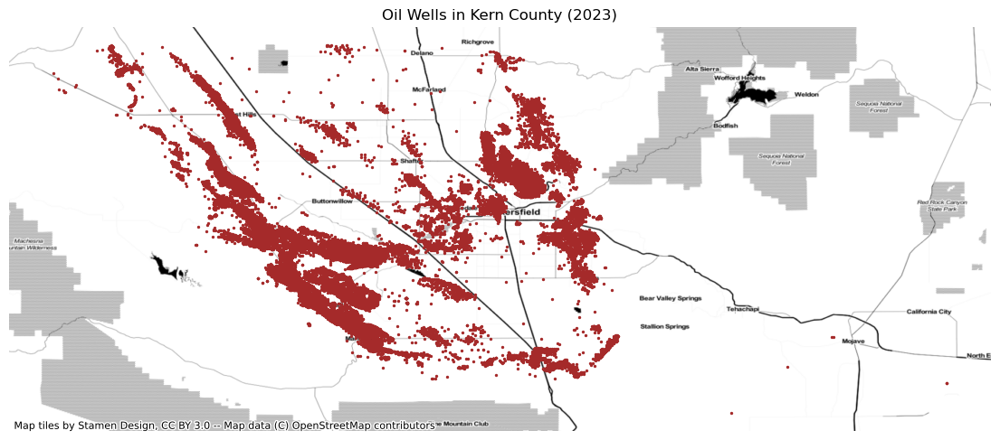

In [36]:
## base map w/ oil locations
fig, ax = plt.subplots(figsize=(14,12))

## choropleth map layer: incidence of asthma
## df.plot(ax=ax,column='majority_race',legend=True,cmap='Oranges', alpha=.6)

## point layer: oil wells
kern_wellsgeo.plot(ax=ax, 
        marker='.',
        markersize=8,
        color='brown')

ax.axis('off')
ax.set_title('Oil Wells in Kern County (2023)')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner, crs=4326)

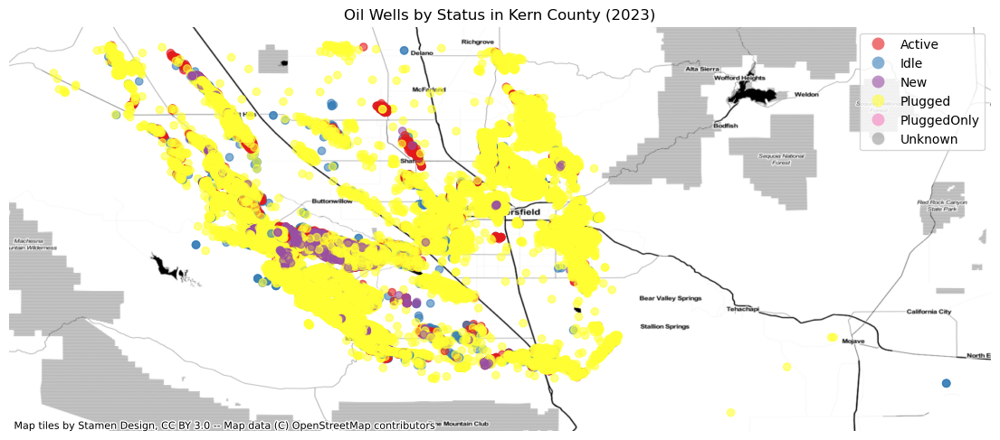

In [37]:
## oil well locations by status

fig, ax = plt.subplots(figsize=(14,12))

## oil locations by well status
kern_wellsgeo.plot(ax=ax,column='WellStatus',legend=True,cmap='Set1', alpha=.6)

## point layer: oil wells
## kern_wellsgeo.plot(ax=ax, 
      ##  marker='.',
      ##  markersize=6,
      ##  color='brown')

ax.axis('off')
ax.set_title('Oil Wells by Status in Kern County (2023)')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner, crs=4326)

## Exploring Cropland in Kern County

Now to explore where and the kind of crops are being grown in the county, so we can begin to compare concentrations of crop land and oil well locations.

In [38]:
import numpy as np
import seaborn
import folium

In [39]:
## loading drop data file
kerncrops = gpd.read_file('kern2022.zip')

In [40]:
kerncrops.shape

(12178, 22)

In [41]:
kerncrops.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 12178 entries, 0 to 12177
Data columns (total 22 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   DT_ACT     12178 non-null  object  
 1   P_STATUS   12178 non-null  object  
 2   PERMIT     12178 non-null  object  
 3   SITEID     12178 non-null  object  
 4   S_STATUS   12178 non-null  object  
 5   DT_INACT   681 non-null    object  
 6   PMT_SITE   12178 non-null  object  
 7   OP_ACT     12178 non-null  object  
 8   OP_INACT   681 non-null    object  
 9   PERMITTEE  12178 non-null  object  
 10  MAILING    12178 non-null  object  
 11  STATE      12177 non-null  object  
 12  TOWNSHIP   12178 non-null  object  
 13  RANGE      12178 non-null  object  
 14  PMT_YEAR   12178 non-null  object  
 15  COMM       12178 non-null  object  
 16  ACRES      12178 non-null  float64 
 17  SECTION    12178 non-null  object  
 18  CITY       12178 non-null  object  
 19  AGENT      12178 

In [42]:
kerncrops.head()

,DT_ACT,P_STATUS,PERMIT,SITEID,S_STATUS,DT_INACT,PMT_SITE,OP_ACT,OP_INACT,PERMITTEE,...,TOWNSHIP,RANGE,PMT_YEAR,COMM,ACRES,SECTION,CITY,AGENT,ZIP,geometry
0,2022-01-01,A,1502038,1315A,A,None,15020381315A,765,None,TEJON RANCH/LAVAL FARMS,...,10N,19W,2022,UNCULTIVATED AG,15.88,15,LEBEC,"MUNOZ/ARMSTRONG,EFREN/MATTHEW",93243,"POLYGON ((6295727.481 2170443.201, 6294851.183..."
1,2022-01-01,A,1502038,1316A,A,None,15020381316A,765,None,TEJON RANCH/LAVAL FARMS,...,10N,19W,2022,UNCULTIVATED AG,40.12,15,LEBEC,"MUNOZ/ARMSTRONG,EFREN/MATTHEW",93243,"POLYGON ((6297283.102 2171251.194, 6297287.236..."
2,2022-01-01,A,1502038,1316B,A,None,15020381316B,765,None,TEJON RANCH/LAVAL FARMS,...,10N,19W,2022,UNCULTIVATED AG,7.32,10,LEBEC,"MUNOZ/ARMSTRONG,EFREN/MATTHEW",93243,"POLYGON ((6297283.102 2171251.194, 6296516.327..."
3,2022-01-01,A,1502038,1318,A,None,15020381318,765,None,TEJON RANCH/LAVAL FARMS,...,10N,19W,2022,ALMOND,84.00,3,LEBEC,"MUNOZ/ARMSTRONG,EFREN/MATTHEW",93243,"POLYGON ((6297314.368 2179098.040, 6297140.186..."
4,2022-01-01,A,1502038,1319,A,None,15020381319,765,None,TEJON RANCH/LAVAL FARMS,...,10N,19W,2022,ALMOND,167.00,3,LEBEC,"MUNOZ/ARMSTRONG,EFREN/MATTHEW",93243,"POLYGON ((6292183.454 2181829.085, 6293212.726..."


In [43]:
kerncrops.columns.to_list()

['DT_ACT',
 'P_STATUS',
 'PERMIT',
 'SITEID',
 'S_STATUS',
 'DT_INACT',
 'PMT_SITE',
 'OP_ACT',
 'OP_INACT',
 'PERMITTEE',
 'MAILING',
 'STATE',
 'TOWNSHIP',
 'RANGE',
 'PMT_YEAR',
 'COMM',
 'ACRES',
 'SECTION',
 'CITY',
 'AGENT',
 'ZIP',
 'geometry']

After reviewing the data, the columns I want to keep include PERMITTEE (Who owns the crop parcel), COMM (what the crop is), ACRES, CITY, and geometry.

In [44]:
## trimming data for desired columns
kerncropstrimmed = kerncrops[['PERMITTEE', 'COMM','ACRES','CITY','geometry']]
kerncropstrimmed.head()

,PERMITTEE,COMM,ACRES,CITY,geometry
0,TEJON RANCH/LAVAL FARMS,UNCULTIVATED AG,15.88,LEBEC,"POLYGON ((6295727.481 2170443.201, 6294851.183..."
1,TEJON RANCH/LAVAL FARMS,UNCULTIVATED AG,40.12,LEBEC,"POLYGON ((6297283.102 2171251.194, 6297287.236..."
2,TEJON RANCH/LAVAL FARMS,UNCULTIVATED AG,7.32,LEBEC,"POLYGON ((6297283.102 2171251.194, 6296516.327..."
3,TEJON RANCH/LAVAL FARMS,ALMOND,84.00,LEBEC,"POLYGON ((6297314.368 2179098.040, 6297140.186..."
4,TEJON RANCH/LAVAL FARMS,ALMOND,167.00,LEBEC,"POLYGON ((6292183.454 2181829.085, 6293212.726..."


In [45]:
## Renaming columns 
kerncropstrimmed.columns = ['Owner', 'Crop','Acres','City','geometry']
kerncropstrimmed.head()

,Owner,Crop,Acres,City,geometry
0,TEJON RANCH/LAVAL FARMS,UNCULTIVATED AG,15.88,LEBEC,"POLYGON ((6295727.481 2170443.201, 6294851.183..."
1,TEJON RANCH/LAVAL FARMS,UNCULTIVATED AG,40.12,LEBEC,"POLYGON ((6297283.102 2171251.194, 6297287.236..."
2,TEJON RANCH/LAVAL FARMS,UNCULTIVATED AG,7.32,LEBEC,"POLYGON ((6297283.102 2171251.194, 6296516.327..."
3,TEJON RANCH/LAVAL FARMS,ALMOND,84.00,LEBEC,"POLYGON ((6297314.368 2179098.040, 6297140.186..."
4,TEJON RANCH/LAVAL FARMS,ALMOND,167.00,LEBEC,"POLYGON ((6292183.454 2181829.085, 6293212.726..."


In [46]:
## exploring crops grown in the county
kerncropstrimmed['Crop'].value_counts()

ALMOND             2636
PISTACHIO          1502
GRAPE              1216
UNCULTIVATED AG     969
ORANGE              673
                   ... 
STRAWBERRY            1
RAPE                  1
OT-PALM               1
MELON-ORGANIC         1
CORN, GRAIN           1
Name: Crop, Length: 183, dtype: int64

It looks like Kern County is a grower of mostly nut orchards. Now to visually quantify what's grown.

In [47]:
## turning "Crop" data into table by type
kerncrop_counts = kerncropstrimmed.value_counts(['Crop']).reset_index(name="Count")
kerncrop_counts

,Crop,Count
0,ALMOND,2636
1,PISTACHIO,1502
2,GRAPE,1216
3,UNCULTIVATED AG,969
4,ORANGE,673
...,...,...
178,PUMPKIN,1
179,RADISH-ORGANIC,1
180,RAPE,1
181,RAPE (LEAFY VEG,1


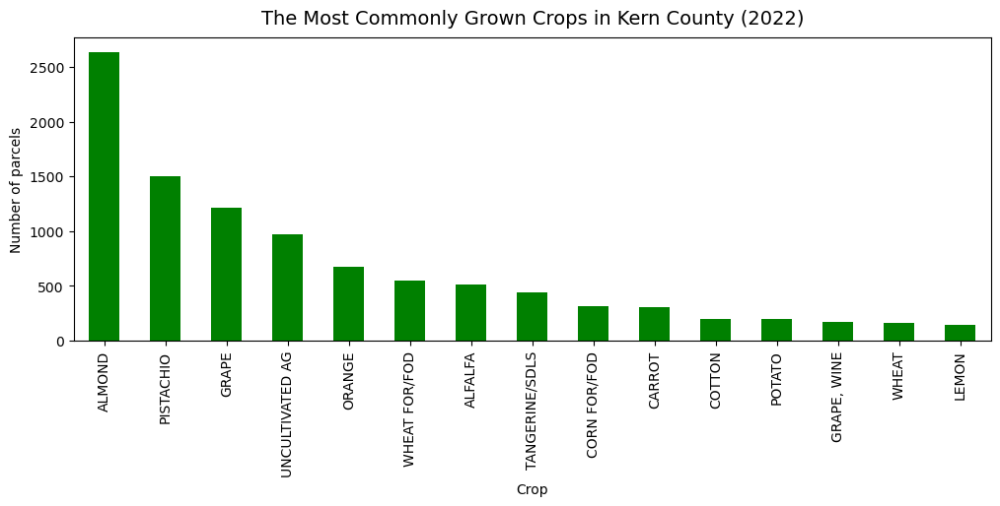

In [48]:
## There are 182 crop types, so plotting the 15 most commonly grown crops in the county
fig, ax = plt.subplots(figsize=(12,4))

kerncrop_counts[:15].plot.bar(ax=ax,
                                      x='Crop',
                                      y='Count',
                                      legend=False,
                                      color='green'
                                      )
ax.set_xlabel('Crop')
ax.set_ylabel('Number of parcels')
ax.set_title("The Most Commonly Grown Crops in Kern County (2022)",fontsize=14,pad=10); # multi-line title with padding

I tried searching for what "uncultivated ag" referred to, but still have no found a clear answer. Will return to this later.

<AxesSubplot: >

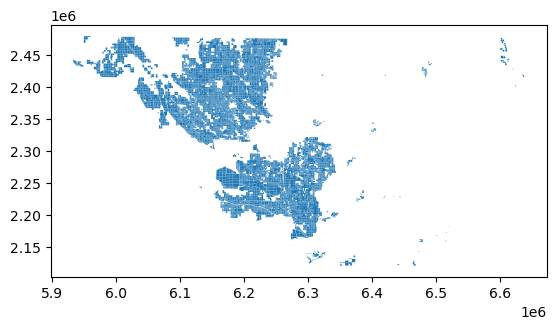

In [49]:
## what would this look like mapped?
kerncropstrimmed.plot()

In [55]:
kerncropstrimmed.crs

<Derived Projected CRS: EPSG:2229>
Name: NAD83 / California zone 5 (ftUS)
Axis Info [cartesian]:
- X[east]: Easting (US survey foot)
- Y[north]: Northing (US survey foot)
Area of Use:
- name: United States (USA) - California - counties Kern; Los Angeles; San Bernardino; San Luis Obispo; Santa Barbara; Ventura.
- bounds: (-121.42, 32.76, -114.12, 35.81)
Coordinate Operation:
- name: SPCS83 California zone 5 (US Survey feet)
- method: Lambert Conic Conformal (2SP)
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

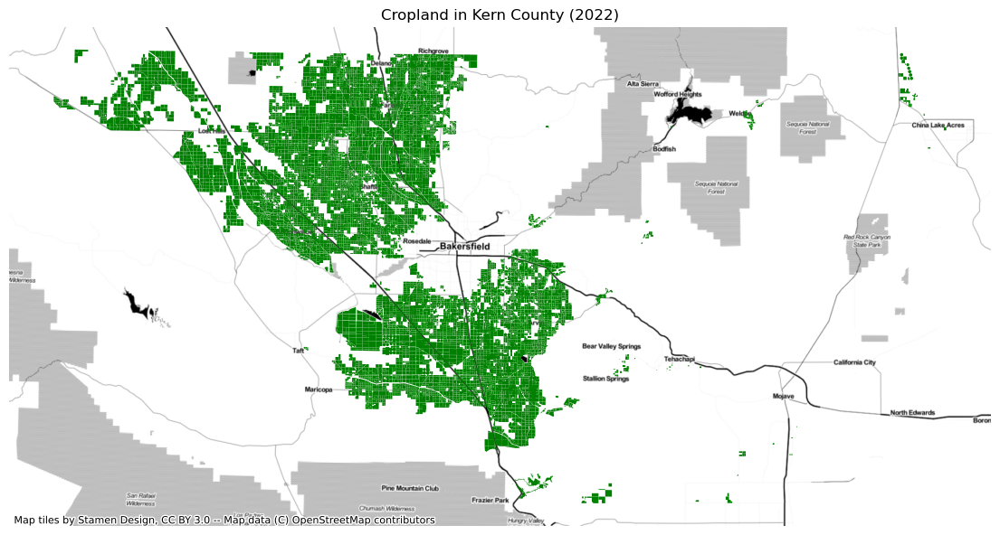

In [56]:
## Static map of crops
fig, ax = plt.subplots(figsize=(14,12))

## choropleth map layer: crop
## legend off: there are too many types of crops and only their locations are relevant here
## kerncropstrimmed.plot(ax=ax,column='Crop',legend=True,cmap='tab20c', alpha=.6)

## map layer based on land used to grow crops
kerncropstrimmed.plot(ax=ax, 
       marker='x',
       markersize=8,
       color='green')

ax.axis('off')
ax.set_title('Cropland in Kern County (2022)')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner, crs=2229)

Creating consolidated "Crop Group" column so Crop type can be mapped more easily (at present 182 types).

In [57]:
pd.set_option("display.max_rows", None)

In [58]:
kerncropstrimmed['Crop'].value_counts()

ALMOND                           2636
PISTACHIO                        1502
GRAPE                            1216
UNCULTIVATED AG                   969
ORANGE                            673
WHEAT FOR/FOD                     547
ALFALFA                           512
TANGERINE/SDLS                    437
CORN FOR/FOD                      311
CARROT                            305
COTTON                            201
POTATO                            198
GRAPE, WINE                       172
WHEAT                             165
LEMON                             149
GRAPE-ORGANIC                     139
CHERRY                            113
TANGERINE                         105
POMEGRANATE                        90
TOMATO PROCESS                     86
TOMATO                             71
TRITICALE                          66
GRAPE, RAISIN                      62
GRAPEFRUIT                         60
GARLIC                             57
ONION DRY ETC                      50
ALMOND-ORGAN

In [59]:
## Creating dictionary 
CropGroups = {'Nut': ['Almond','Pistachio'],
              'Fruit': ['STRAWBERRY','BLACKBERRY','MELON-ORGANIC','MANGO','APRICOT-ORGANIC','NECTARINE-ORGANIC','APPLE-ORGANIC','TANGELO-ORGANIC'],
              'Vegetable': ['RADISH-ORGANIC','LETTUCE LEAF-ORGANIC','SWISS CHARD-ORGANIC','CUCUMBER-ORGANIC','PARSLEY-ORGANIC','CABBAGE-ORGANIC','FENNEL-ORGANIC','ONION SEED'],
              'Grain': ['CORN, GRAIN'],
              'Other': ['SUNFLOWER-ORGANIC','SOD FARM (TURF)'],
             'Unknown': ['UNCULTIVATED AG']}

In [ ]:
## Crop Groups (Nuts, Fruits, Vegetables, Grain, Unknown)
kerncropstrimmed['Crop_Group'] = ''
kerncropstrimmed['Crop']
kerncropstrimmed[kerncropstrimmed['Crop'] == 'Almond', 'Crop_Group'] = 'Nuts'

### Merging Cropland Data to CalEnviroScreen Data

In [60]:
## Opening CalEnviroScreen 4.0 data downloaded from the CalEnviroScreen website
CESdata = gpd.read_file('calenviroscreen40shpf2021shp.zip')

In [61]:
CESdata.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 8035 entries, 0 to 8034
Data columns (total 67 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   Tract       8035 non-null   float64 
 1   ZIP         8035 non-null   int64   
 2   County      8035 non-null   object  
 3   ApproxLoc   8035 non-null   object  
 4   TotPop19    8035 non-null   int64   
 5   CIscore     8035 non-null   float64 
 6   CIscoreP    8035 non-null   float64 
 7   Ozone       8035 non-null   float64 
 8   OzoneP      8035 non-null   float64 
 9   PM2_5       8035 non-null   float64 
 10  PM2_5_P     8035 non-null   float64 
 11  DieselPM    8035 non-null   float64 
 12  DieselPM_P  8035 non-null   float64 
 13  Pesticide   8035 non-null   float64 
 14  PesticideP  8035 non-null   float64 
 15  Tox_Rel     8035 non-null   float64 
 16  Tox_Rel_P   8035 non-null   float64 
 17  Traffic     8035 non-null   float64 
 18  TrafficP    8035 non-null   float64 
 19

In [63]:
CESdata['County'].value_counts() ## 151 obs for Kern (though 236 census tracts in other datasets)

Los Angeles        2343
San Diego           627
Orange              582
Riverside           453
Santa Clara         372
San Bernardino      369
Alameda             360
Sacramento          317
Contra Costa        207
Fresno              199
San Francisco       195
Ventura             173
San Mateo           157
Kern                151
San Joaquin         139
Sonoma               99
Solano               96
Stanislaus           94
Monterey             93
Santa Barbara        89
Placer               84
Tulare               78
Marin                55
San Luis Obispo      53
Santa Cruz           52
Butte                51
Merced               49
Shasta               48
El Dorado            42
Yolo                 41
Napa                 40
Imperial             31
Humboldt             30
Kings                27
Madera               23
Sutter               21
Mendocino            20
Nevada               20
Lake                 15
Yuba                 14
Siskiyou             14
San Benito      

In [66]:
## Subsetting for Kern County
Kern_env = CESdata[CESdata.County == 'Kern']
Kern_env.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 151 entries, 1402 to 1552
Data columns (total 67 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   Tract       151 non-null    float64 
 1   ZIP         151 non-null    int64   
 2   County      151 non-null    object  
 3   ApproxLoc   151 non-null    object  
 4   TotPop19    151 non-null    int64   
 5   CIscore     151 non-null    float64 
 6   CIscoreP    151 non-null    float64 
 7   Ozone       151 non-null    float64 
 8   OzoneP      151 non-null    float64 
 9   PM2_5       151 non-null    float64 
 10  PM2_5_P     151 non-null    float64 
 11  DieselPM    151 non-null    float64 
 12  DieselPM_P  151 non-null    float64 
 13  Pesticide   151 non-null    float64 
 14  PesticideP  151 non-null    float64 
 15  Tox_Rel     151 non-null    float64 
 16  Tox_Rel_P   151 non-null    float64 
 17  Traffic     151 non-null    float64 
 18  TrafficP    151 non-null    float64 
 

In [69]:
## "Tract" is still a float; converting to a string
Kern_env['Tract'] = Kern_env['Tract'].astype(np.str)
Kern_env['Tract'].info()

<class 'pandas.core.series.Series'>
Int64Index: 151 entries, 1402 to 1552
Series name: Tract
Non-Null Count  Dtype 
--------------  ----- 
151 non-null    object
dtypes: object(1)
memory usage: 2.4+ KB


/tmp/ipykernel_85/2424451276.py:2: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Kern_env['Tract'] = Kern_env['Tract'].astype(np.str)


In [70]:
Kern_env.sample(3)

,Tract,ZIP,County,ApproxLoc,TotPop19,CIscore,CIscoreP,Ozone,OzoneP,PM2_5,...,Elderly65,Hispanic,White,AfricanAm,NativeAm,OtherMult,Shape_Leng,Shape_Area,AAPI,geometry
1416,6029000908.0,93306,Kern,Bakersfield,5104,25.776709,50.529501,0.064647,93.627878,15.152469,...,10.0118,48.4718,43.5149,5.9365,0.5878,1.3323,6104.165154,2.086512e+06,0.1567,"POLYGON ((95674.681 -289075.299, 95945.617 -28..."
1505,6029001901.0,93304,Kern,Bakersfield,3697,45.586401,82.715582,0.064647,93.627878,15.771482,...,11.9556,48.3906,41.0333,8.6286,0.2705,0.4598,5599.913226,1.726553e+06,1.2172,"POLYGON ((88072.322 -295594.031, 87196.622 -29..."
1445,6029004302.0,93280,Kern,Wasco,5571,-999.000000,-999.000000,0.060311,82.476665,13.469460,...,0.4667,54.6940,16.7654,21.2529,0.8796,4.7209,8132.740642,3.980224e+06,1.6874,"POLYGON ((52446.896 -270650.156, 52431.391 -26..."


In [72]:
Kern_env['Tract'] = Kern_env['Tract'].str.zfill(11)

In [73]:
Kern_env['Tract'].sample(3)

1413    6029005506.0
1454    6029002819.0
1473    6029002302.0
Name: Tract, dtype: object

In [75]:
Kern_env.crs

<Derived Projected CRS: EPSG:3310>
Name: NAD83 / California Albers
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: United States (USA) - California.
- bounds: (-124.45, 32.53, -114.12, 42.01)
Coordinate Operation:
- name: California Albers
- method: Albers Equal Area
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [76]:
kerncropstrimmed.crs

<Derived Projected CRS: EPSG:2229>
Name: NAD83 / California zone 5 (ftUS)
Axis Info [cartesian]:
- X[east]: Easting (US survey foot)
- Y[north]: Northing (US survey foot)
Area of Use:
- name: United States (USA) - California - counties Kern; Los Angeles; San Bernardino; San Luis Obispo; Santa Barbara; Ventura.
- bounds: (-121.42, 32.76, -114.12, 35.81)
Coordinate Operation:
- name: SPCS83 California zone 5 (US Survey feet)
- method: Lambert Conic Conformal (2SP)
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [78]:
## adjusting projections for dataframes which are on different systems
kerncropstrimmed_mercator=kerncropstrimmed.to_crs(3857)
Kern_env_mercator=Kern_env.to_crs(3857)

In [80]:
kerncropstrimmed_mercator=kerncropstrimmed.to_crs("EPSG:4326")
Kern_env_mercator = Kern_env.to_crs("EPSG:4326") 

<AxesSubplot: >

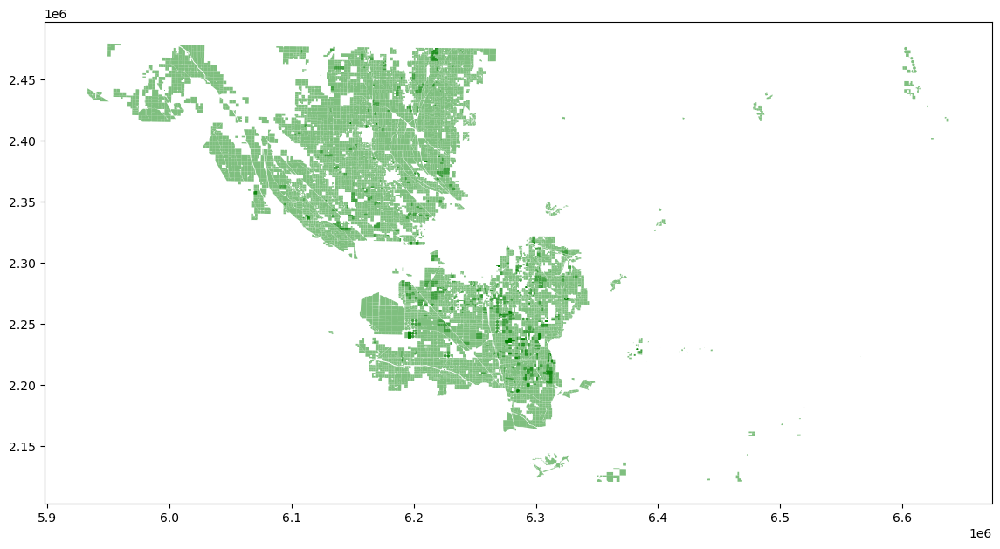

In [83]:
## Checking whether dataframes align
fig,ax = plt.subplots(figsize=(14,12))
# Kern_env.plot(ax=ax,facecolor='#ccc',edgecolor='white',lw=0.2)
kerncropstrimmed.plot(ax=ax,color='green',markersize=10,marker='.',alpha=0.5)

### Overlaying Oil & Gas Well Locatons on Cropland in Kern County

In [89]:
## Pulling Census Tract data from Census Reporter
kern_tracts = gpd.read_file('acs2021_5yr_B99181_14000US06029003305.geojson')

In [90]:
kern_tracts.head()

,geoid,name,B99181001,"B99181001, Error",B99181002,"B99181002, Error",B99181003,"B99181003, Error",geometry
0,05000US06029,"Kern County, CA",877629.0,-1.0,90838.0,-1.0,786791.0,-1.0,"MULTIPOLYGON (((-119.91366 35.43926, -119.9232..."
1,14000US06029000102,"Census Tract 1.02, Kern, CA",2965.0,-1.0,377.0,-1.0,2588.0,-1.0,"MULTIPOLYGON (((-119.02148 35.43994, -119.0202..."
2,14000US06029000103,"Census Tract 1.03, Kern, CA",5218.0,-1.0,344.0,-1.0,4874.0,-1.0,"MULTIPOLYGON (((-119.03902 35.42290, -119.0389..."
3,14000US06029000104,"Census Tract 1.04, Kern, CA",1241.0,-1.0,171.0,-1.0,1070.0,-1.0,"MULTIPOLYGON (((-119.03879 35.44175, -119.0387..."
4,14000US06029000105,"Census Tract 1.05, Kern, CA",3979.0,-1.0,584.0,-1.0,3395.0,-1.0,"MULTIPOLYGON (((-119.03904 35.43414, -119.0365..."


In [91]:
## Creating Kern FIPS variable
## Trimming dataset
kern_tracts = kern_tracts[['geoid','geometry']].copy()
kern_tracts

,geoid,geometry
0,05000US06029,"MULTIPOLYGON (((-119.91366 35.43926, -119.9232..."
1,14000US06029000102,"MULTIPOLYGON (((-119.02148 35.43994, -119.0202..."
2,14000US06029000103,"MULTIPOLYGON (((-119.03902 35.42290, -119.0389..."
3,14000US06029000104,"MULTIPOLYGON (((-119.03879 35.44175, -119.0387..."
4,14000US06029000105,"MULTIPOLYGON (((-119.03904 35.43414, -119.0365..."
...,...,...
232,14000US06029006404,"MULTIPOLYGON (((-118.93218 35.23783, -118.9321..."
233,14000US06029006405,"MULTIPOLYGON (((-118.93211 35.27421, -118.9321..."
234,14000US06029006406,"MULTIPOLYGON (((-118.91441 35.25257, -118.9144..."
235,14000US06029006500,"MULTIPOLYGON (((-118.30742 34.97458, -118.3069..."


In [92]:
## Creating a 'FIPS' variable using the 'geoid' variable
kern_tracts['FIPS'] = kern_tracts['geoid']

In [93]:
kern_tracts['FIPS'].head()

0          05000US06029
1    14000US06029000102
2    14000US06029000103
3    14000US06029000104
4    14000US06029000105
Name: FIPS, dtype: object

In [94]:
## Isolating the rows with census tracts only (removing the row with the County)
kern_tracts = kern_tracts.loc[1:236].copy()
kern_tracts

,geoid,geometry,FIPS
1,14000US06029000102,"MULTIPOLYGON (((-119.02148 35.43994, -119.0202...",14000US06029000102
2,14000US06029000103,"MULTIPOLYGON (((-119.03902 35.42290, -119.0389...",14000US06029000103
3,14000US06029000104,"MULTIPOLYGON (((-119.03879 35.44175, -119.0387...",14000US06029000104
4,14000US06029000105,"MULTIPOLYGON (((-119.03904 35.43414, -119.0365...",14000US06029000105
5,14000US06029000106,"MULTIPOLYGON (((-119.08437 35.44132, -119.0838...",14000US06029000106
...,...,...,...
232,14000US06029006404,"MULTIPOLYGON (((-118.93218 35.23783, -118.9321...",14000US06029006404
233,14000US06029006405,"MULTIPOLYGON (((-118.93211 35.27421, -118.9321...",14000US06029006405
234,14000US06029006406,"MULTIPOLYGON (((-118.91441 35.25257, -118.9144...",14000US06029006406
235,14000US06029006500,"MULTIPOLYGON (((-118.30742 34.97458, -118.3069...",14000US06029006500


In [95]:
## Removing the extra characters in the values for the new FIPS column
kern_tracts['FIPS'] = '0'+kern_tracts['FIPS'].str.lstrip('14000US')
kern_tracts['FIPS'].copy()

1      06029000102
2      06029000103
3      06029000104
4      06029000105
5      06029000106
          ...     
232    06029006404
233    06029006405
234    06029006406
235    06029006500
236    06029006600
Name: FIPS, Length: 236, dtype: object

In [96]:
kern_tracts.head()

,geoid,geometry,FIPS
1,14000US06029000102,"MULTIPOLYGON (((-119.02148 35.43994, -119.0202...",06029000102
2,14000US06029000103,"MULTIPOLYGON (((-119.03902 35.42290, -119.0389...",06029000103
3,14000US06029000104,"MULTIPOLYGON (((-119.03879 35.44175, -119.0387...",06029000104
4,14000US06029000105,"MULTIPOLYGON (((-119.03904 35.43414, -119.0365...",06029000105
5,14000US06029000106,"MULTIPOLYGON (((-119.08437 35.44132, -119.0838...",06029000106


FIPS have been created for Kern County. Now, to use this data to overlay census tracts in the County on the map of land used for crops.

In [97]:
kern_tracts.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [59]:
# reprojecting dataframes to mercator
kern_wellsgeo_mercator=kern_wellsgeo.to_crs(3857)
kerncropstrimmed_mercator=kerncropstrimmed.to_crs(3857)

In [ ]:
kern_tracts_mercator=kern_tracts.to_crs(3857)

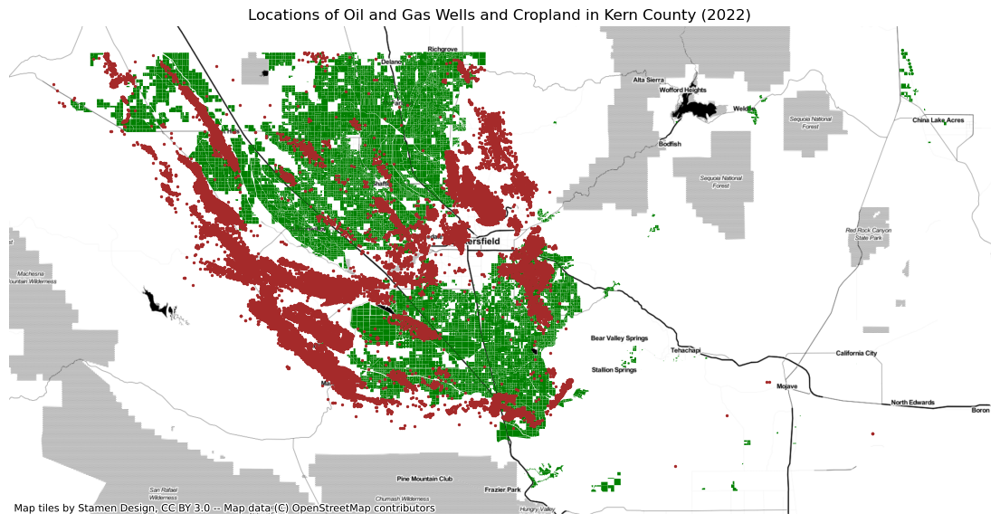

In [70]:
## Adding oil well locations to cropland on the map
fig, ax = plt.subplots(figsize=(14,12))

## map layer based on land used to grow crops
kerncropstrimmed_mercator.plot(ax=ax, 
       marker='x',
       markersize=8,
       color='green')

kern_wellsgeo_mercator.plot(ax=ax, 
        marker='.',
        markersize=8,
        color='brown')

ax.axis('off')
ax.set_title('Locations of Oil and Gas Wells and Cropland in Kern County (2022)')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner, crs=3857)

In [2]:
## Adding oil well locations by status to cropland on the map
fig, ax = plt.subplots(figsize=(14,12))

## map layer based on land used to grow crops
kerncropstrimmed_mercator.plot(ax=ax, 
       marker='.',
       markersize=8,
       color='green')

kern_wellsgeo_mercator.plot(ax=ax,column='WellStatus',legend=True,cmap='Set1', alpha=.6)

ax.axis('off')
ax.set_title('Locations of Oil and Gas Wells (by Status) and Cropland in Kern County (2022)')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner, crs=3857)

NameError: name 'plt' is not defined

It's difficult to see where the "Active" wells are on this map even though there are over 40K of them, so I'm going to create a subset of oil well data that excludes the "Plugged" wells, which make up the majority of the wells but are probably just obscuring the "Active" wells on this map.

In [72]:
## Creating a subset of well data w/o the "Plugged" wells
kern_OGwells2 = kern_OGwells[kern_OGwells.WellStatus != 'Plugged']
kern_OGwells2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41669 entries, 7 to 156305
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   Operator    41669 non-null  object  
 1   WellStatus  41669 non-null  object  
 2   WellType    41669 non-null  object  
 3   Latitude    41669 non-null  float64 
 4   Longitude   41669 non-null  float64 
 5   geometry    41669 non-null  geometry
dtypes: float64(2), geometry(1), object(3)
memory usage: 2.2+ MB


Worked -- well locations are now down to over 40K.

In [73]:
## reconverting trimmed df into gdf
kern_wellsgeo2 = gpd.GeoDataFrame(kern_OGwells2, 
                       crs='epsg:4326',
                       geometry=gpd.points_from_xy(kern_OGwells2.Longitude, kern_OGwells2.Latitude))

In [74]:
kern_wellsgeo2_mercator=kern_wellsgeo2.to_crs(3857)

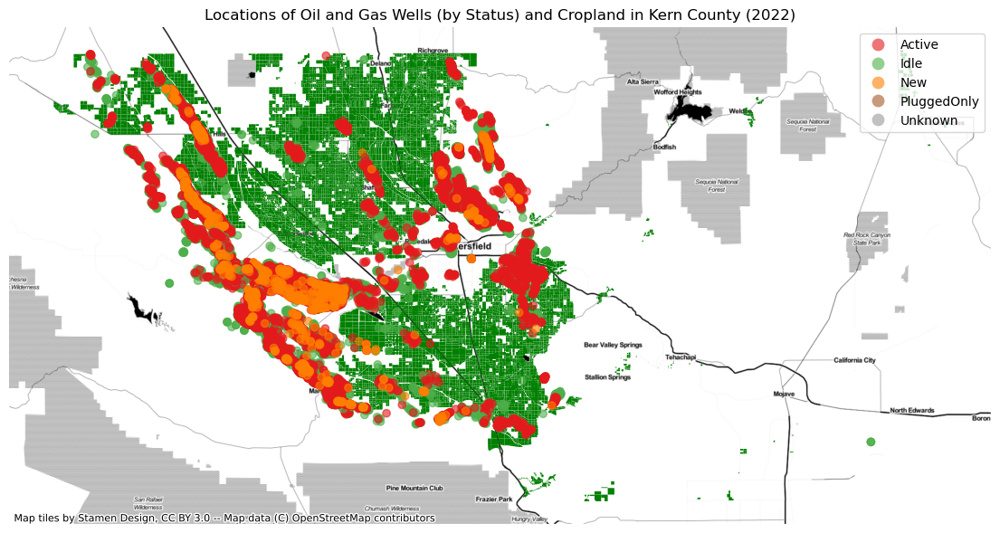

In [75]:
## Oil well locations by status sans "Plugged" wells on cropland map
fig, ax = plt.subplots(figsize=(14,12))

## map layer based on land used to grow crops
kerncropstrimmed_mercator.plot(ax=ax, 
       marker='x',
       markersize=8,
       color='green')

kern_wellsgeo2_mercator.plot(ax=ax,column='WellStatus',legend=True,cmap='Set1', alpha=.6)

ax.axis('off')
ax.set_title('Locations of Oil and Gas Wells (by Status) and Cropland in Kern County (2022)')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner, crs=3857)

Placing original map with only cropland identified here again for comparison.

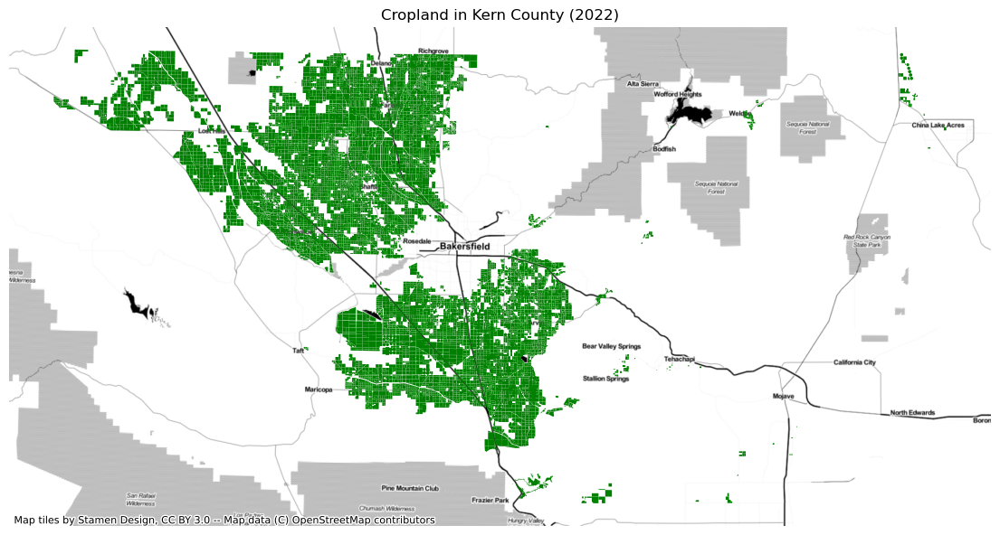

In [76]:
## Static map of crops
fig, ax = plt.subplots(figsize=(14,12))

## choropleth map layer: crop
## legend off: there are too many types of crops and only their locations are relevant here
## kerncropstrimmed.plot(ax=ax,column='Crop',legend=True,cmap='tab20c', alpha=.6)

## map layer based on land used to grow crops
kerncropstrimmed.plot(ax=ax, 
       marker='x',
       markersize=8,
       color='green')

ax.axis('off')
ax.set_title('Cropland in Kern County (2022)')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner, crs=2229)

## Mapping Incidence of Low Birth Weight Data and Oil Well Locations

In [82]:
## Opening CalEnviroScreen 4.0 data downloaded from the CalEnviroScreen website
CESdata = gpd.read_file('calenviroscreen40shpf2021shp.zip')

In [83]:
CESdata.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 8035 entries, 0 to 8034
Data columns (total 67 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   Tract       8035 non-null   float64 
 1   ZIP         8035 non-null   int64   
 2   County      8035 non-null   object  
 3   ApproxLoc   8035 non-null   object  
 4   TotPop19    8035 non-null   int64   
 5   CIscore     8035 non-null   float64 
 6   CIscoreP    8035 non-null   float64 
 7   Ozone       8035 non-null   float64 
 8   OzoneP      8035 non-null   float64 
 9   PM2_5       8035 non-null   float64 
 10  PM2_5_P     8035 non-null   float64 
 11  DieselPM    8035 non-null   float64 
 12  DieselPM_P  8035 non-null   float64 
 13  Pesticide   8035 non-null   float64 
 14  PesticideP  8035 non-null   float64 
 15  Tox_Rel     8035 non-null   float64 
 16  Tox_Rel_P   8035 non-null   float64 
 17  Traffic     8035 non-null   float64 
 18  TrafficP    8035 non-null   float64 
 19

In [84]:
CESdata['Tract'] = CESdata['Tract'].astype(np.str)

/tmp/ipykernel_75/1505030956.py:1: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  CESdata['Tract'] = CESdata['Tract'].astype(np.str)


In [85]:
CESdata['Tract'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 8035 entries, 0 to 8034
Series name: Tract
Non-Null Count  Dtype 
--------------  ----- 
8035 non-null   object
dtypes: object(1)
memory usage: 62.9+ KB


In [86]:
CESdata.head()

,Tract,ZIP,County,ApproxLoc,TotPop19,CIscore,CIscoreP,Ozone,OzoneP,PM2_5,...,Elderly65,Hispanic,White,AfricanAm,NativeAm,OtherMult,Shape_Leng,Shape_Area,AAPI,geometry
0,6083002103.0,93454,Santa Barbara,Santa Maria,4495,36.019653,69.162885,0.034190,10.566273,7.567724,...,12.5028,68.9210,20.8899,0.4004,0.2670,1.3126,6999.357689,2.847611e+06,8.2091,"POLYGON ((-39795.070 -341919.191, -38126.384 -..."
1,6083002402.0,93455,Santa Barbara,Santa Maria,13173,37.030667,70.637922,0.035217,11.561917,7.624775,...,5.3519,78.6229,13.2240,2.5051,0.0000,0.9489,19100.578232,1.635292e+07,4.6990,"POLYGON ((-39795.070 -341919.191, -39803.632 -..."
2,6083002102.0,93454,Santa Barbara,Santa Maria,2398,31.213140,61.069087,0.034190,10.566273,7.548835,...,12.8857,65.7214,30.6088,0.9591,0.0000,2.1685,4970.985897,1.352329e+06,0.5421,"POLYGON ((-38115.747 -341130.248, -38126.384 -..."
3,6083002010.0,93455,Santa Barbara,Orcutt,4496,6.639331,5.988401,0.036244,13.615432,7.660570,...,14.4128,22.9537,69.1948,0.9342,0.7117,2.5356,6558.956012,2.417717e+06,3.6699,"POLYGON ((-37341.662 -348530.437, -37252.307 -..."
4,6083002009.0,93455,Santa Barbara,Orcutt,4008,14.022852,23.121533,0.036244,13.615432,7.663210,...,18.8872,33.4082,59.7804,0.6986,1.4721,1.3723,6570.368730,2.608422e+06,3.2685,"POLYGON ((-39465.107 -348499.262, -38244.305 -..."


In [87]:
CESdata['FIPS'] = '0'+CESdata['Tract']

In [88]:
CESdata.head()

,Tract,ZIP,County,ApproxLoc,TotPop19,CIscore,CIscoreP,Ozone,OzoneP,PM2_5,...,Hispanic,White,AfricanAm,NativeAm,OtherMult,Shape_Leng,Shape_Area,AAPI,geometry,FIPS
0,6083002103.0,93454,Santa Barbara,Santa Maria,4495,36.019653,69.162885,0.034190,10.566273,7.567724,...,68.9210,20.8899,0.4004,0.2670,1.3126,6999.357689,2.847611e+06,8.2091,"POLYGON ((-39795.070 -341919.191, -38126.384 -...",06083002103.0
1,6083002402.0,93455,Santa Barbara,Santa Maria,13173,37.030667,70.637922,0.035217,11.561917,7.624775,...,78.6229,13.2240,2.5051,0.0000,0.9489,19100.578232,1.635292e+07,4.6990,"POLYGON ((-39795.070 -341919.191, -39803.632 -...",06083002402.0
2,6083002102.0,93454,Santa Barbara,Santa Maria,2398,31.213140,61.069087,0.034190,10.566273,7.548835,...,65.7214,30.6088,0.9591,0.0000,2.1685,4970.985897,1.352329e+06,0.5421,"POLYGON ((-38115.747 -341130.248, -38126.384 -...",06083002102.0
3,6083002010.0,93455,Santa Barbara,Orcutt,4496,6.639331,5.988401,0.036244,13.615432,7.660570,...,22.9537,69.1948,0.9342,0.7117,2.5356,6558.956012,2.417717e+06,3.6699,"POLYGON ((-37341.662 -348530.437, -37252.307 -...",06083002010.0
4,6083002009.0,93455,Santa Barbara,Orcutt,4008,14.022852,23.121533,0.036244,13.615432,7.663210,...,33.4082,59.7804,0.6986,1.4721,1.3723,6570.368730,2.608422e+06,3.2685,"POLYGON ((-39465.107 -348499.262, -38244.305 -...",06083002009.0


In [89]:
## Trimming for variables of interest
health = CESdata[['geometry', 'FIPS', 'County','LowBirtWt', 'LowBirWP']]
health.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 8035 entries, 0 to 8034
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   geometry   8035 non-null   geometry
 1   FIPS       8035 non-null   object  
 2   County     8035 non-null   object  
 3   LowBirtWt  8035 non-null   float64 
 4   LowBirWP   8035 non-null   float64 
dtypes: float64(2), geometry(1), object(2)
memory usage: 314.0+ KB


In [90]:
health.head()

,geometry,FIPS,County,LowBirtWt,LowBirWP
0,"POLYGON ((-39795.070 -341919.191, -38126.384 -...",06083002103.0,Santa Barbara,6.01,75.327175
1,"POLYGON ((-39795.070 -341919.191, -39803.632 -...",06083002402.0,Santa Barbara,4.00,26.635874
2,"POLYGON ((-38115.747 -341130.248, -38126.384 -...",06083002102.0,Santa Barbara,4.95,51.013600
3,"POLYGON ((-37341.662 -348530.437, -37252.307 -...",06083002010.0,Santa Barbara,2.65,5.683859
4,"POLYGON ((-39465.107 -348499.262, -38244.305 -...",06083002009.0,Santa Barbara,6.22,79.278933


In [94]:
health_Kern = health[health.County == 'Kern']
health_Kern['County'].value_counts()

Kern    151
Name: County, dtype: int64

In [95]:
## Identifying ranges for map legend

## Identifying % values for 25% and 75% quartiles
health_Kern['LowBirtWt'].quantile([0.25,0.5,0.75])

0.25    4.175
0.50    5.380
0.75    6.390
Name: LowBirtWt, dtype: float64

In [96]:
print(health_Kern['LowBirtWt'].min())
print(health_Kern['LowBirtWt'].max())

-999.0
9.35


In [97]:
## Seems like there are some missing values
## finding missing values across columns
print(health_Kern['LowBirtWt'].value_counts()[-999.0]) ## 5 values to note for later

5


In [99]:
## Variable to qualitatively incidence of low birth weight
health_Kern['LowBirthWeightScale'] = '3: High - More than 6.4% of live births'
health_Kern.loc[health_Kern['LowBirtWt'] <6.4, 'LowBirthWeightScale'] = '2: Moderate - 4.2% to 6.4% of live births'
health_Kern.loc[health_Kern['LowBirtWt'] <4.2, 'LowBirthWeightScale'] = '1: Low - Less than 4.2% of live births'
health_Kern['LowBirthWeightScale'].sample(5)

1531    2: Moderate - 4.2% to 6.4% of live births
1445       1: Low - Less than 4.2% of live births
1490    2: Moderate - 4.2% to 6.4% of live births
1530      3: High - More than 6.4% of live births
1450    2: Moderate - 4.2% to 6.4% of live births
Name: LowBirthWeightScale, dtype: object

In [1]:
## Map of incidence of low birth weight
health_Kern.plot(
    figsize = (20,12),
    column = 'LowBirthWeightScale',
    cmap = 'YlOrRd',
    legend = True,
    legend_kwds={
               'loc': 'lower left',
               'bbox_to_anchor':(1,1)
            })

NameError: name 'health_Kern' is not defined

Now to overlay this info onto the map of oil and gas wells by status in the county.

In [102]:
health_Kern.crs

<Derived Projected CRS: EPSG:3310>
Name: NAD83 / California Albers
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: United States (USA) - California.
- bounds: (-124.45, 32.53, -114.12, 42.01)
Coordinate Operation:
- name: California Albers
- method: Albers Equal Area
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [103]:
health_Kern_mercator=health_Kern.to_crs(3857)

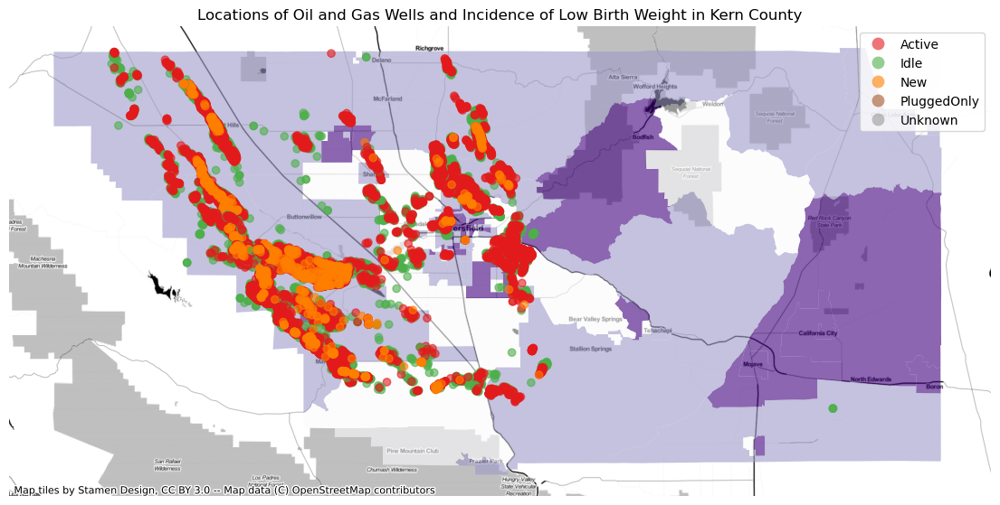

In [112]:
## Oil well locations by status sans "Plugged" wells on cropland map
fig, ax = plt.subplots(figsize=(14,12))

## map layer based on land used to grow crops
health_Kern_mercator.plot(ax=ax,column='LowBirthWeightScale',legend=True,cmap='Purples', alpha=.6)

kern_wellsgeo2_mercator.plot(ax=ax,column='WellStatus',legend=True,cmap='Set1', alpha=.6)

ax.axis('off')
ax.set_title('Locations of Oil and Gas Wells and Incidence of Low Birth Weight in Kern County')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner, crs=3857)

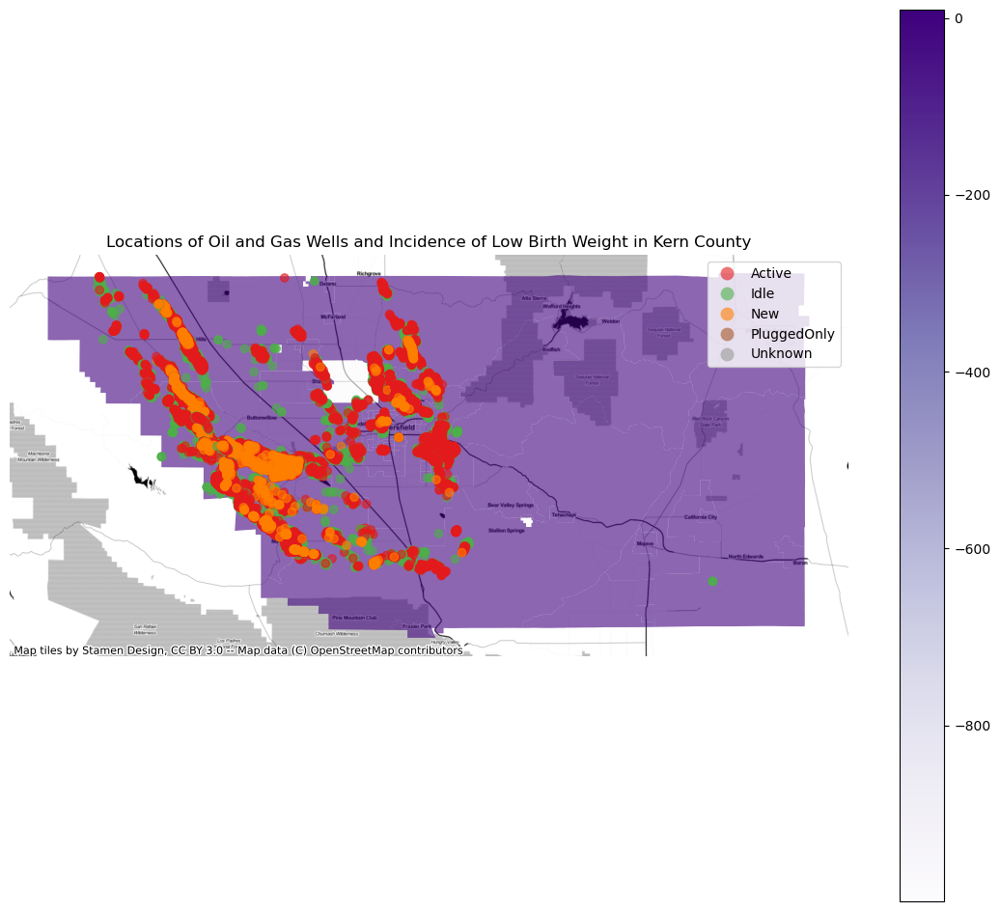

In [106]:
## Oil well locations by status sans "Plugged" wells on cropland map
fig, ax = plt.subplots(figsize=(14,12))

## map layer based on land used to grow crops
health_Kern_mercator.plot(ax=ax,column='LowBirtWt',legend=True,cmap='Purples', alpha=.6)

kern_wellsgeo2_mercator.plot(ax=ax,column='WellStatus',legend=True,cmap='Set1', alpha=.6)

ax.axis('off')
ax.set_title('Locations of Oil and Gas Wells and Incidence of Low Birth Weight in Kern County')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner, crs=3857)

In [117]:
## Adding Agricultural and Land Workers as a Proportion of the Labor Force as layer
## centering Kern County: 35.4937° N, 118.8597° W
Kern_lowbirthweight = folium.Map(location=[35.4,-118.8], 
               zoom_start = 8,
               tiles='CartoDB positron', 
               attribution='CartoDB')

folium.Choropleth(
                  geo_data=health_Kern_mercator, 
                  data=health_Kern_mercator,         
                  key_on='feature.properties.FIPS', 
                  columns=['FIPS', 'LowBirtWt'], 
                  fill_color='Oranges',
                  line_weight=0.1, 
                  fill_opacity=0.8,
                  line_opacity=0.2, 
                  legend_name='Low Birth Weight in Kern County (2021)').add_to(Kern_lowbirthweight)
Kern_lowbirthweight

In [119]:
folium.GeoJson(kern_wellsgeo2_mercator, name="geojson").add_to(Kern_lowbirthweight)
folium.LayerControl().add_to(Kern_lowbirthweight)
Kern_lowbirthweight